## Import

In [1]:
# 파일 확인
!ls "./data"

ha2.txt_structured.csv		 model_plot.png
HDFS_100k.log_anomaly_label.csv  SHISO_syslog.txt_structured.csv
HDFS_100k.log_structured.csv	 SHISO_syslog.txt_templates.csv
LenMa_syslog.txt_structured.csv  syslog.csv
LenMa_syslog.txt_templates.csv	 syslog.txt
log_model_HDFS.h5		 syslog.xls
log_model-testing.h5		 weblog.csv
LSTM_model_plot.png


In [2]:
# import section

import keras
from keras import regularizers
from keras.models import load_model
from keras.models import  Model, Sequential
from keras.layers import Dense, Input, LSTM ,Embedding , TimeDistributed, BatchNormalization
import numpy as np
import pandas as pd
from sklearn.ensemble import IsolationForest

## Data load

In [3]:
struct_log = './data/HDFS_100k.log_structured.csv' # The structured log file
label_file = './data/HDFS_100k.log_anomaly_label.csv' # The anomaly label file

In [4]:
df = pd.read_csv(struct_log)
df.head()

,LineId,Date,Time,Pid,Level,Component,Content,EventId,EventTemplate
0,1,81109,203518,143,INFO,dfs.DataNode$DataXceiver,Receiving block blk_-1608999687919862906 src: ...,E5,Receiving block <*> src: /<*> dest: /<*>
1,2,81109,203518,35,INFO,dfs.FSNamesystem,BLOCK* NameSystem.allocateBlock: /mnt/hadoop/m...,E22,BLOCK* NameSystem.allocateBlock:<*>
2,3,81109,203519,143,INFO,dfs.DataNode$DataXceiver,Receiving block blk_-1608999687919862906 src: ...,E5,Receiving block <*> src: /<*> dest: /<*>
3,4,81109,203519,145,INFO,dfs.DataNode$DataXceiver,Receiving block blk_-1608999687919862906 src: ...,E5,Receiving block <*> src: /<*> dest: /<*>
4,5,81109,203519,145,INFO,dfs.DataNode$PacketResponder,PacketResponder 1 for block blk_-1608999687919...,E11,PacketResponder <*> for block <*> terminating


In [5]:
from utils import dataloader
from utils.preprocessing import Vectorizer_sys


batch_size = 32
hidden_size = 32
num_directions = 2
topk = 5
train_ratio = 0.2
window_size = 10
epoches = 2
num_workers = 2
device = 0 

x_, window_y_ = \
dataloader.load_HDFS(struct_log, window='session',window_size=window_size, train_ratio=train_ratio, split_type='uniform', Time = True)


====== Input data summary ======
Loading ./data/HDFS_100k.log_structured.csv
Slicing 1406 sessions, with window 10
Slicing done, 96459 windows generated
Train: windows


In [6]:
feature_extractor = Vectorizer_sys()
train_dataset = feature_extractor.fit_transform(x_, window_y_)

In [7]:
train_dataset

{'SessionId': array([   0,    1,    1, ..., 1403, 1404, 1405]),
 'window_y': array([1, 3, 1, ..., 1, 1, 1]),
 'x': array([[4, 9, 1, ..., 1, 1, 1],
        [4, 4, 5, ..., 6, 3, 3],
        [4, 5, 5, ..., 3, 3, 3],
        ...,
        [0, 0, 1, ..., 1, 1, 1],
        [0, 1, 1, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1]])}

In [8]:
train_x = train_dataset['x']/17

In [9]:
train_x

array([[0.23529412, 0.52941176, 0.05882353, ..., 0.05882353, 0.05882353,
        0.05882353],
       [0.23529412, 0.23529412, 0.29411765, ..., 0.35294118, 0.17647059,
        0.17647059],
       [0.23529412, 0.29411765, 0.29411765, ..., 0.17647059, 0.17647059,
        0.17647059],
       ...,
       [0.        , 0.        , 0.05882353, ..., 0.05882353, 0.05882353,
        0.05882353],
       [0.        , 0.05882353, 0.05882353, ..., 0.05882353, 0.05882353,
        0.05882353],
       [0.        , 0.        , 0.        , ..., 0.05882353, 0.05882353,
        0.05882353]])

## Isolation Forest

In [10]:
clf = IsolationForest(random_state = 42, contamination = 0.3)
clf.fit(train_x)
pred = clf.predict(train_x)

p1 = train_x[pred==1]
p2 = train_x[pred==-1]

In [11]:
print('Abnormal data count : {}'.format(len(p2)))
print('Normal data count : {}'.format(len(p1)))

Abnormal data count : 28938
Normal data count : 67521


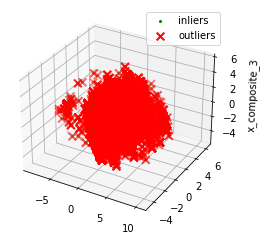

In [12]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D
pca = PCA(n_components=3) 
scaler = StandardScaler()
#normalize the metrics
X = scaler.fit_transform(train_dataset['x'])
X_reduce = pca.fit_transform(X)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_zlabel("x_composite_3")
# Plot the compressed data points
ax.scatter(X_reduce[:, 0], X_reduce[:, 1], zs=X_reduce[:, 2], s=4, lw=1, label="inliers",c="green")
# Plot x's for the ground truth outliers
ax.scatter(X_reduce[list(pred==-1),0],X_reduce[list(pred==-1),1], X_reduce[list(pred==-1),2],
           lw=2, s=60, marker="x", c="red", label="outliers")
ax.legend()
plt.show()


## NN Autoencoder

In [13]:
# NN Autoencoder model.
input_dim = p1.shape[1]
input = Input(shape=(input_dim, ))
encode = Dense(input_dim//3*2, activation='relu',kernel_regularizer=regularizers.l2(0.01))(input)
encode = BatchNormalization()(encode)
encode = Dense(input_dim//3, activation='relu',kernel_regularizer=regularizers.l2(0.01))(encode)
encode = BatchNormalization()(encode)

decode = Dense(input_dim//3, activation='relu')(encode)
decode = BatchNormalization()(decode)
decode = Dense(input_dim//3*2, activation='relu')(decode)
decode = BatchNormalization()(decode)
decode = Dense(input_dim, activation='sigmoid')(decode)

autoencoder = Model(input, decode)

autoencoder.compile(optimizer='adam',
            loss='binary_crossentropy',
            metrics=['accuracy'])

# Train model.
history = autoencoder.fit(p1, p1,
        epochs=100,
        batch_size=128,
        shuffle=True
        )

Epoch 1/100
528/528 [==============================] - 2s 2ms/step - loss: 0.7806 - accuracy: 0.0592
Epoch 2/100
528/528 [==============================] - 1s 2ms/step - loss: 0.6035 - accuracy: 0.0406
Epoch 3/100
528/528 [==============================] - 1s 2ms/step - loss: 0.5948 - accuracy: 0.1213
Epoch 4/100
528/528 [==============================] - 1s 2ms/step - loss: 0.5938 - accuracy: 0.3250
Epoch 5/100
528/528 [==============================] - 1s 2ms/step - loss: 0.5936 - accuracy: 0.3242
Epoch 6/100
528/528 [==============================] - 1s 2ms/step - loss: 0.5936 - accuracy: 0.3104
Epoch 7/100
528/528 [==============================] - 1s 2ms/step - loss: 0.5936 - accuracy: 0.2795
Epoch 8/100
528/528 [==============================] - 1s 2ms/step - loss: 0.5937 - accuracy: 0.2923
Epoch 9/100
528/528 [==============================] - 1s 2ms/step - loss: 0.5938 - accuracy: 0.3099
Epoch 10/100
528/528 [==============================] - 1s 1ms/step - loss: 0.5935 - accura

In [14]:
p1

array([[0.23529412, 0.23529412, 0.29411765, ..., 0.35294118, 0.17647059,
        0.17647059],
       [0.23529412, 0.29411765, 0.29411765, ..., 0.17647059, 0.17647059,
        0.17647059],
       [0.23529412, 0.23529412, 0.29411765, ..., 0.35294118, 0.47058824,
        0.17647059],
       ...,
       [0.35294118, 0.29411765, 0.35294118, ..., 0.29411765, 0.35294118,
        0.29411765],
       [0.29411765, 0.35294118, 0.29411765, ..., 0.35294118, 0.29411765,
        0.35294118],
       [0.17647059, 0.17647059, 0.17647059, ..., 0.29411765, 0.35294118,
        0.05882353]])

## LSTM Autoencoder

In [15]:
expand_p1 = np.expand_dims(p1,axis=1)

In [16]:
# LSTM Autoencoder
model = Sequential()

# Encoder
model.add(LSTM(8, activation='relu', input_shape=(1,10), return_sequences=True, kernel_regularizer=regularizers.l2(0.01)))
model.add(LSTM(4, activation='relu', return_sequences=True, kernel_regularizer=regularizers.l2(0.01)))
model.add(LSTM(1, activation='relu', return_sequences=True, kernel_regularizer=regularizers.l2(0.01)))
# model.add(RepeatVector(10))

# Decoder
model.add(LSTM(4, activation='relu', return_sequences=True))
model.add(LSTM(8, activation='relu', return_sequences=True))
model.add(TimeDistributed(Dense(10)))

In [16]:
model.compile(loss='mse', optimizer='adam',metrics=['accuracy'])

# fit
history = model.fit(expand_p1, expand_p1,
                     epochs=200, batch_size=128)

racy: 0.4278
Epoch 6/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0038 - accuracy: 0.4165
Epoch 7/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0038 - accuracy: 0.4238
Epoch 8/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0038 - accuracy: 0.3607
Epoch 9/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0038 - accuracy: 0.4063
Epoch 10/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0037 - accuracy: 0.4025
Epoch 11/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0038 - accuracy: 0.3533
Epoch 12/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0038 - accuracy: 0.3716
Epoch 13/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0038 - accuracy: 0.3566
Epoch 14/200
528/528 [==============================] - 2s 3ms/step - loss: 0.0038 - accuracy: 0.3361
Epoch 15/200
528/528 [==============================] - 2s 3ms/step - los

## Reference
* Unsupervised log message anomaly detection : https://www.sciencedirect.com/science/article/pii/S2405959520300643